In [1]:
using Flux, Statistics
using Flux.Data: DataLoader
using Flux: onehotbatch, onecold, @epochs
using Flux.Losses: logitcrossentropy
using Base: @kwdef
using MLDatasets
using Plots

In [2]:
include("network.jl")
include("vsa.jl")
include("spiking.jl")

zero_nans (generic function with 1 method)

# Load the dataset

In [4]:
function getdata(args)
    ENV["DATADEPS_ALWAYS_ACCEPT"] = "true"

    @info "Getting and transforming data"

    ## Load dataset
    xtrain, ytrain = MLDatasets.FashionMNIST(:train)[:]
    xtest, ytest = MLDatasets.FashionMNIST(:test)[:]

    ## Reshape input data to flatten each image into a linear array
    xtrain = Flux.flatten(xtrain)
    xtest = Flux.flatten(xtest)

    ## One-hot-encode the labels
    ytrain, ytest = onehotbatch(ytrain, 0:9), onehotbatch(ytest, 0:9)

    ## Create two DataLoader objects (mini-batch iterators)
    train_loader = DataLoader((xtrain, ytrain), batchsize=args.batchsize, shuffle=true)
    test_loader = DataLoader((xtest, ytest), batchsize=args.batchsize)

    return train_loader, test_loader
end

getdata (generic function with 1 method)

In [5]:
LayerNorm(1)

LayerNorm(1)        # 2 parameters

In [6]:
function build_model(; imgsize=(28,28,1), nclasses=10, nhidden::Int=128)
    return Chain(
                  PhasorDense(prod(imgsize) => nhidden),
                  PhasorDense(nhidden => nclasses))
end

build_model (generic function with 1 method)

In [7]:
@kwdef mutable struct Args
    η::Float64 = 3e-4       ## learning rate
    batchsize::Int = 256    ## batch size
    epochs::Int = 10        ## number of epochs
    use_cuda::Bool = false   ## use gpu (if cuda available)
end

Args

In [8]:
train_loader, test_loader = getdata(Args())

[ Info: Getting and transforming data


(DataLoader(::Tuple{Matrix{Float32}, OneHotArrays.OneHotMatrix{UInt32, Vector{UInt32}}}, shuffle=true, batchsize=256), DataLoader(::Tuple{Matrix{Float32}, OneHotArrays.OneHotMatrix{UInt32, Vector{UInt32}}}, batchsize=256))

In [9]:
x, y = first(train_loader)

(Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], Bool[0 0 … 0 0; 0 0 … 0 0; … ; 0 0 … 0 0; 0 0 … 0 1])

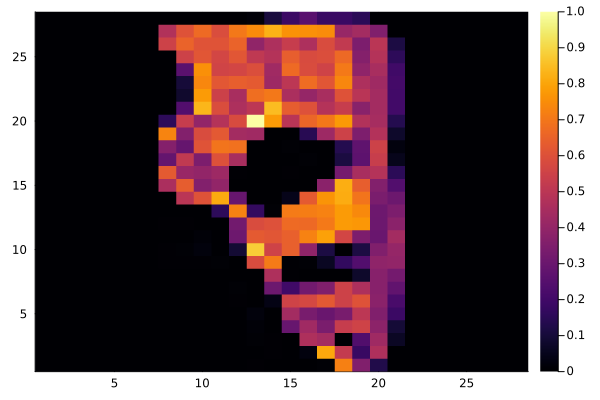

In [10]:
heatmap(reshape(x'[1,:], (28, 28)))

# Build the phasor model

In [11]:
phasor_model = build_model()

Chain(
  PhasorDense(784 => 128),              # 100_480 parameters
  PhasorDense(128 => 10),               # 1_290 parameters
)                   # Total: 4 arrays, 101_770 parameters, 398.328 KiB.

In [12]:
y_naive = phasor_model(x');

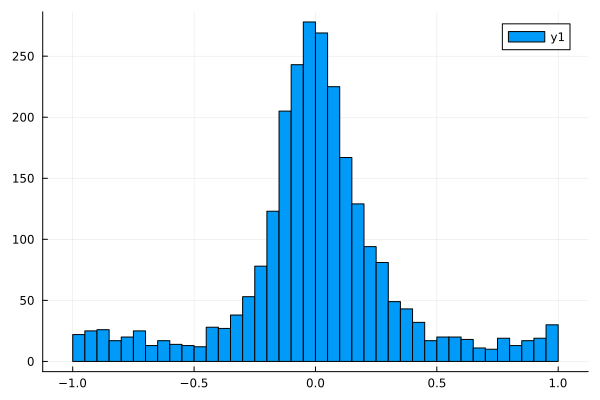

In [13]:
histogram(y_naive |> vec)

## test the correlation of static & dynamic phases

In [14]:
spk_args = SpikingArgs(2*pi, -0.2, 1.0, 0.02, 0.02, 0.01)

Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)


In [15]:
x_train = phase_to_train(x', spk_args, repeats = 10)

Spike Train: (256, 784) with 2007040 spikes.

In [16]:
x_call = SpikingCall(x_train, spk_args, (0.0, 10.0))

SpikingCall(Spike Train: (256, 784) with 2007040 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [17]:
y_spk_1 = phasor_model[1](x_call)

SpikingCall(Spike Train: (256, 128) with 305803 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [18]:
@time y_spk = phasor_model(x_call)

 10.366357 seconds (819.96 k allocations: 46.132 GiB, 8.66% gc time, 1.55% compilation time)


SpikingCall(Spike Train: (256, 10) with 23880 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [19]:
naive_spiking_phases = train_to_phase(y_spk);

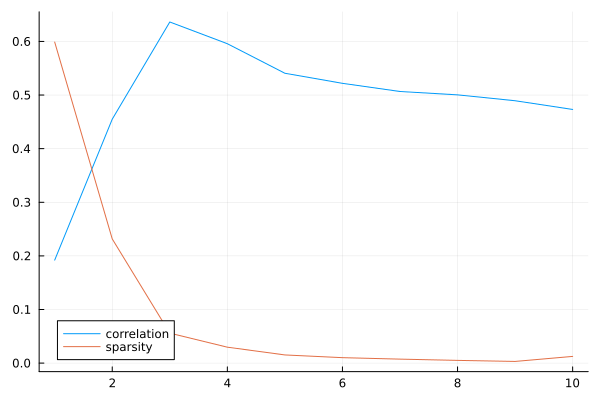

In [20]:
plot(cycle_correlation(y_naive, naive_spiking_phases), label="correlation")
plot!(count_nans(naive_spiking_phases) ./ prod(y_spk.train.shape), label="sparsity")

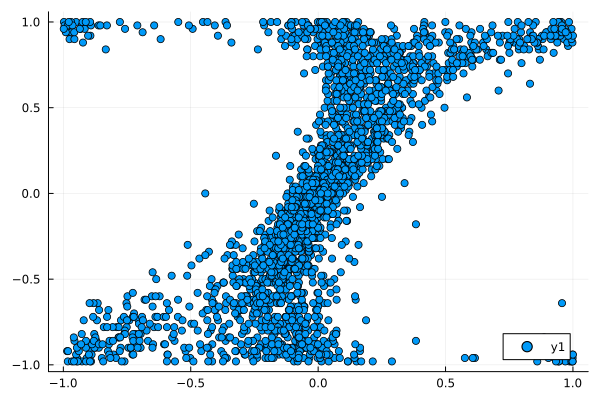

In [21]:
scatter(y_naive |> vec, naive_spiking_phases[5,:,:] |> vec)

## test the pre-train accuracy

In [22]:
mean(accuracy_quadrature(y_naive, y))

0.05859375

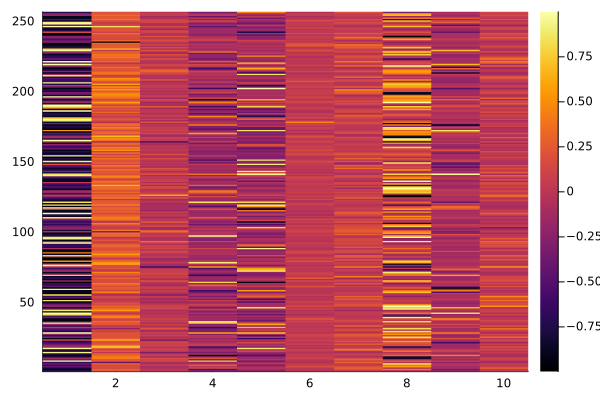

In [23]:
heatmap(y_naive)

In [24]:
function zero_nans(phases::AbstractArray)
    nans = isnan.(phases)
    phases[nans] .= 0.0
    return phases
end

zero_nans (generic function with 1 method)

In [25]:
zero_nans(naive_spiking_phases)

10×256×10 Array{Float64, 3}:
[:, :, 1] =
  0.0    0.0    0.0    0.0    0.0   …   0.0    0.0    0.0    0.0    0.0
 -0.98   0.8   -0.64  -0.62  -0.68      0.0    0.0    0.0   -0.52  -0.9
 -0.84  -0.98  -0.76  -0.68  -0.74     -0.8    1.0   -0.28  -0.5   -0.86
 -0.82  -0.96  -0.9   -0.72  -0.74     -0.88  -0.92  -0.3   -0.5   -0.86
 -0.82  -0.92  -0.94  -0.8   -0.72     -0.88  -0.86  -0.32  -0.52  -0.9
 -0.8   -0.94  -0.94  -0.86  -0.72  …  -0.88  -0.84  -0.34  -0.5   -0.9
 -0.8   -0.94  -0.96  -0.88  -0.72     -0.88  -0.84  -0.36  -0.48  -0.9
 -0.8   -0.92  -0.96  -0.9   -0.72     -0.88  -0.84  -0.36  -0.46  -0.9
 -0.8   -0.92  -0.96  -0.92  -0.72     -0.88  -0.82  -0.38  -0.44  -0.9
 -0.8   -0.9   -0.96  -0.92  -0.7      -0.88  -0.82  -0.4   -0.44  -0.9

[:, :, 2] =
 0.0   -0.06  0.0   0.0   0.0   -0.08  …  0.0   0.0   -0.02        0.0   0.0
 0.06   0.0   0.02  0.06  0.04  -0.1      0.12  0.2   -0.06        0.04  0.1
 0.3    0.02  0.08  0.14  0.04   0.94     0.28  0.34  -3.9968e-14  0.1

In [26]:
function loss_and_accuracy(data_loader, model, mode="static")
    acc = 0
    ls = 0.0f0
    num = 0
    for (x, y) in data_loader
        ŷ = model(x')
        
        ls += sum(quadrature_loss(ŷ, y'))
        acc += sum(accuracy_quadrature(ŷ, y)) ## Decode the output of the model
        num +=  size(x)[end]
    end
    return ls / num, acc / num
end

loss_and_accuracy (generic function with 2 methods)

In [27]:
function accuracy(data_loader, model, spk_args::SpikingArgs, t_span::Tuple{<:Real, <:Real}; repeats::Int = 3)
    acc = []
    n_phases = []
    num = 0

    for (x, y) in data_loader
        train = phase_to_train(x', spk_args, repeats=repeats)
        call = SpikingCall(train, spk_args, t_span)
        spk_output = model(call)
        ŷ = train_to_phase(spk_output)
        
        append!(acc, sum.(accuracy_quadrature(ŷ, y))') ## Decode the output of the model
        num +=  size(x)[end]
    end

    return acc, num
end

accuracy (generic function with 1 method)

In [28]:
loss_and_accuracy(test_loader, phasor_model)

(0.4357696693395888, 0.0533)

In [29]:
right, num = accuracy(test_loader, phasor_model, spk_args, (0.0, 10.0))

(Any[25, 22, 24, 23, 32, 35, 33, 35, 35, 29  …  0, 0, 1, 1, 1, 2, 2, 2, 3, 2], 10000)

In [30]:
sum(reshape(right, 10, :), dims=2) ./ num

10×1 Matrix{Float64}:
 0.1
 0.0674
 0.0806
 0.0928
 0.1006
 0.1058
 0.1052
 0.1063
 0.1113
 0.108

## Train the model

In [31]:
using Zygote: withgradient

In [32]:
function train(model; kws...)
    args = Args(; kws...) ## Collect options in a struct for convenience

    # if CUDA.functional() && args.use_cuda
    #     @info "Training on CUDA GPU"
    #     CUDA.allowscalar(false)
    #     device = gpu
    # else
        @info "Training on CPU"
        device = cpu
    # end

    ## Create test and train dataloaders
    train_loader, test_loader = getdata(args)

    @info "Constructing model and starting training"
    ## Construct model
    #model = build_model() |> device

    ## Optimizer
    opt = Flux.setup(Adam(args.η), model)
    losses = []

    ## Training
    for epoch in 1:args.epochs
        for (x, y) in train_loader
            x, y = transpose(device(x)), transpose(device(y)) ## transfer data to device
            loss, gs = withgradient(m -> mean(quadrature_loss(m(x), y)), model) ## compute gradient of the loss
            append!(losses, loss)
            Flux.Optimise.update!(opt, model, gs[1]) ## update parameters
        end

        ## Report on train and test
        train_loss, train_acc = loss_and_accuracy(train_loader, model)
        test_loss, test_acc = loss_and_accuracy(test_loader, model)
        println("Epoch=$epoch")
        println("  train_loss = $train_loss, train_accuracy = $train_acc")
        println("  test_loss = $test_loss, test_accuracy = $test_acc")
    end

    return losses
end

train (generic function with 1 method)

In [33]:
opt = Flux.setup(Adam(3e-4), phasor_model)

(layers = ((weight = Leaf(Adam{Float64}(0.0003, (0.9, 0.999), 1.0e-8), (Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], (0.9, 0.999))), bias = Leaf(Adam{Float64}(0.0003, (0.9, 0.999), 1.0e-8), ([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], (0.9, 0.999)))), (weight = Leaf(Adam{Float64}(0.0003, (0.9, 0.999), 1.0e-8), (Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], (0.9, 0.999))), bias = Leaf(Adam{Float64}(0.0003, (0.9, 0.999), 1.0e-8), ([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], (0.9, 0.999))))),)

In [34]:
l = train(phasor_model)

[ Info: Training on CPU
[ Info: Getting and transforming data
[ Info: Constructing model and starting training


Epoch=1
  train_loss = 0.040998271224230894, train_accuracy = 0.8021333333333334
  test_loss = 0.04243616223562324, test_accuracy = 0.7862
Epoch=2
  train_loss = 0.03516128085056347, train_accuracy = 0.8289333333333333
  test_loss = 0.03656422813467089, test_accuracy = 0.8166
Epoch=3
  train_loss = 0.032337149796698196, train_accuracy = 0.8421333333333333
  test_loss = 0.034081470918000345, test_accuracy = 0.828
Epoch=4
  train_loss = 0.030273059341034046, train_accuracy = 0.8531333333333333
  test_loss = 0.032282546337278506, test_accuracy = 0.8346
Epoch=5
  train_loss = 0.028685199349966946, train_accuracy = 0.8583166666666666
  test_loss = 0.030990758533488958, test_accuracy = 0.8421
Epoch=6
  train_loss = 0.027754262127885343, train_accuracy = 0.86495
  test_loss = 0.03022550342928593, test_accuracy = 0.8441
Epoch=7
  train_loss = 0.02705431746861786, train_accuracy = 0.8689833333333333
  test_loss = 0.029553228896813534, test_accuracy = 0.8478
Epoch=8
  train_loss = 0.026251635031

2350-element Vector{Any}:
 0.4307508179827265
 0.3416016570941838
 0.267849244376302
 0.20345746816979604
 0.15129699402944471
 0.1406352147349798
 0.1303860103804375
 0.12166853821692203
 0.11857405005300058
 0.11488169015921225
 0.10881134762104161
 0.10537279486654975
 0.1000127632446296
 ⋮
 0.024632809304850706
 0.020779724808864752
 0.02410823705190219
 0.022522700375670744
 0.02408962552794176
 0.022297498356323334
 0.027834577454549644
 0.021629057094747814
 0.02698699919974069
 0.026111906497229703
 0.027326477252078332
 0.034983695219512057

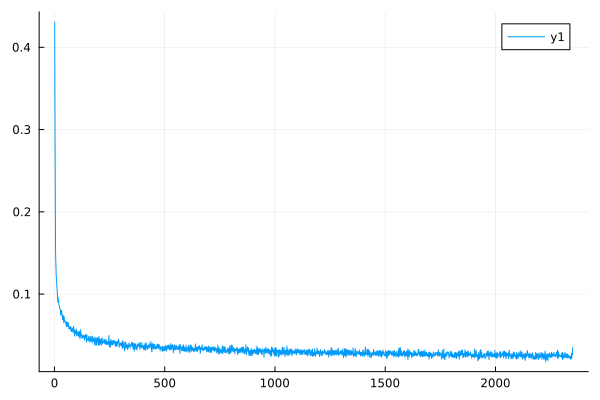

In [35]:
plot(l)

In [36]:
y_pred = phasor_model(x');

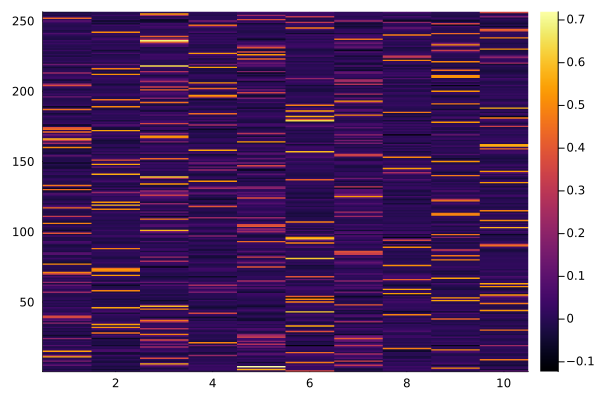

In [37]:
heatmap(y_pred)

In [38]:
y_layer1 = phasor_model[1](x');

In [39]:
y_layer1_spk = phasor_model[1](x_call)

SpikingCall(Spike Train: (256, 128) with 318057 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [40]:
y_spk = phasor_model(x_call)

SpikingCall(Spike Train: (256, 10) with 23918 spikes., Neuron parameters: Period 1.0 (s)
Current kernel duration: 0.02 (s)
Threshold: 0.02 (V)
, (0.0, 10.0))

In [41]:
y_layer1_phase = train_to_phase(y_layer1_spk);

In [42]:
y_phase = train_to_phase(y_spk);

In [43]:
scatter(y_layer1 |> vec, y_layer1_phase[2,:,:] |> vec, alpha=0.02)

In [44]:
scatter(y_layer1 |> vec, y_layer1_phase[3,:,:] |> vec, alpha=0.02)

In [45]:
scatter(y_layer1 |> vec, y_layer1_phase[4,:,:] |> vec, alpha=0.02)

In [47]:
scatter(y_layer1 |> vec, y_layer1_phase[5,:,:] |> vec, alpha=0.05)

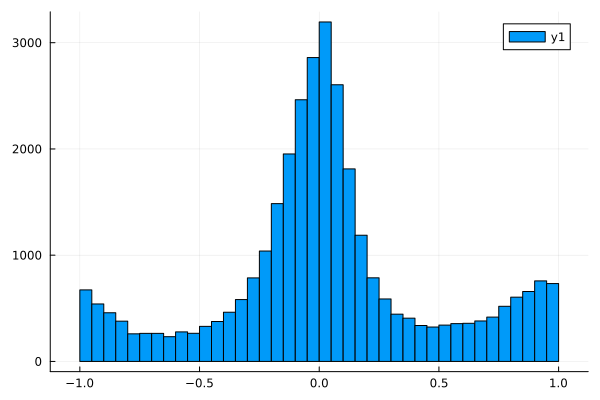

In [48]:
histogram(y_layer1 |> vec)

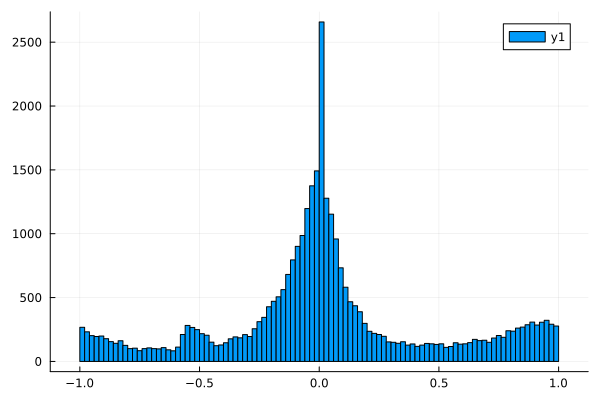

In [49]:
histogram(zero_nans(y_layer1_phase[2,:,:]) |> vec)

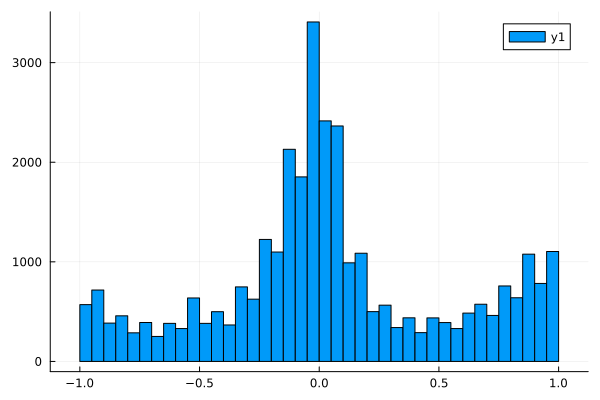

In [50]:
histogram(zero_nans(y_layer1_phase[3,:,:]) |> vec)

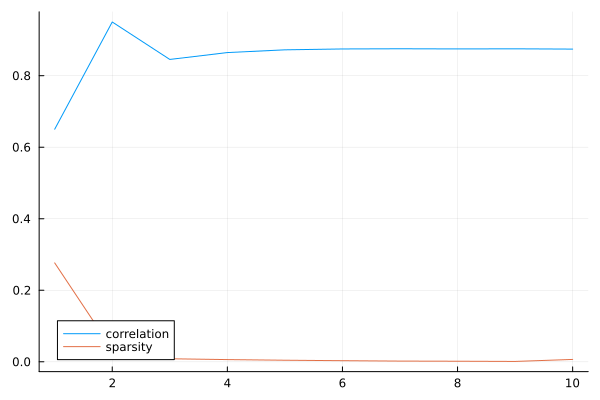

In [51]:
plot(cycle_correlation(y_layer1, y_layer1_phase), label="correlation")
plot!(count_nans(y_layer1_phase) ./ prod(y_layer1_spk.train.shape), label="sparsity")

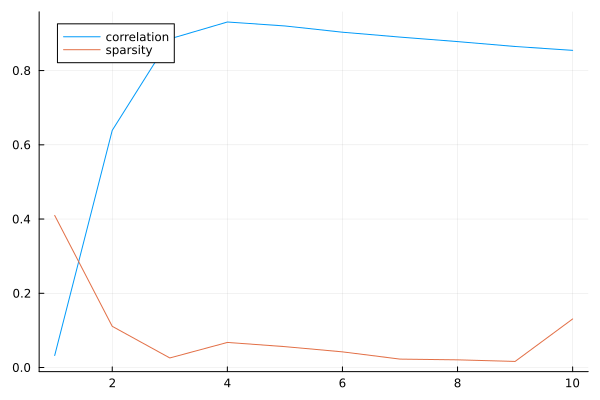

In [52]:
plot(cycle_correlation(y_pred, y_phase), label="correlation")
plot!(count_nans(y_phase) ./ prod(y_spk.train.shape), label="sparsity")

In [53]:
spk_accuracy =accuracy_quadrature(y_phase, y)

10-element Vector{BitMatrix}:
 [0; 1; … ; 0; 0;;]
 [0; 0; … ; 1; 0;;]
 [1; 1; … ; 1; 0;;]
 [0; 1; … ; 1; 1;;]
 [1; 1; … ; 1; 0;;]
 [1; 0; … ; 1; 0;;]
 [1; 1; … ; 1; 0;;]
 [1; 1; … ; 1; 0;;]
 [1; 1; … ; 0; 0;;]
 [0; 0; … ; 0; 0;;]

In [54]:
sum.(spk_accuracy)

10-element Vector{Int64}:
  60
  79
 175
 114
 123
 136
 159
 159
 169
  47

In [55]:
loss_and_accuracy(test_loader, phasor_model)

(0.027943718530516942, 0.8568)

In [56]:
right, num = accuracy(test_loader, phasor_model, spk_args, (0.0, 10.0), repeats=10)

(Any[56, 97, 161, 117, 115, 127, 151, 158, 168, 48  …  3, 7, 13, 8, 9, 12, 8, 9, 13, 1], 10000)

In [57]:
reshape(right, 10, :)

10×40 Matrix{Any}:
  56   60   59   50   51   45   43   52  …   51   41   50   48   42   54   3
  97   85   77   93   92  111   81   96      92   60   80   72   86   97   7
 161  176  166  165  175  165  163  172     179  166  176  168  173  174  13
 117   93  101  105  114  102  117  109     119   90  108  115  107  103   8
 115  124  115  126  129  127  126  124     117  115  121  113  121  117   9
 127  130  130  138  127  134  148  120  …  135  117  147  136  116  119  12
 151  141  152  149  140  151  164  140     147  118  146  134  127  134   8
 158  158  145  135  161  144  161  157     157  135  153  142  135  143   9
 168  162  157  160  159  151  159  161     169  131  159  160  140  150  13
  48   51   40   44   53   32   51   49      40   47   53   54   48   39   1

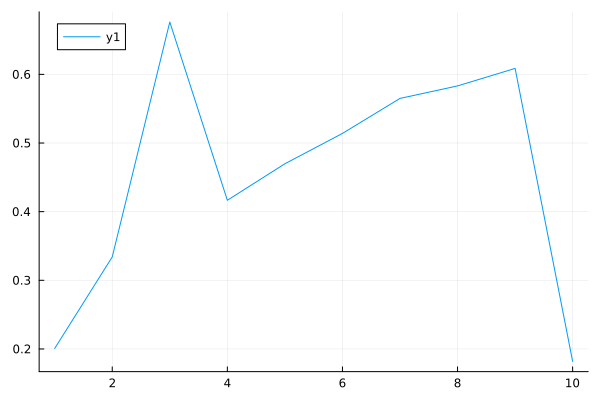

In [58]:
plot(sum(reshape(right, 10, :), dims=2) ./ num)